In [7]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
from scipy.io import wavfile
from pathlib import Path

In [8]:
audio_files = [f for f in Path('./data').glob('*.wav')]

In [9]:
example = str(audio_files[0])

### FF implementation
![DFT](https://wikimedia.org/api/rest_v1/media/math/render/svg/393b5c5a5c668495629828600cde4611b0fa2f5a)
- DFT: discrete Fourier Transform

- Pad: recurisive implementation require input is radix 2
- FFT: recurisive 1D FFT
![FFT](https://miro.medium.com/max/2200/1*6eg5KjF4TrZ8xVvF51PoVA.png)
- FFT_vectorized: non-recurisive vetorized FFT
- fftfreq: get the coresponding fft frequency

In [26]:
def DFT(x):
    x = np.asarray(x, dtype=float)
    N = x.shape[0]
    n = np.arange(N)
    k = n.reshape((N, 1))
    M = np.exp(-2j * np.pi * k * n / N)
    return np.dot(M, x)

def pad(lst):
    '''padding the list to next nearest power of 2'''
    k = 0
    while 2**k < len(lst):
        k += 1
    return np.concatenate((lst, ([0] * (2 ** k - len(lst)))))

def FFT(x,leaf_cut = 128):
    """A recursive of the 1D FFT"""
    x = np.asarray(x, dtype=float)
    N = x.shape[0]

    if N % 2 > 0:
        raise ValueError("the input size must be 2^n")
    elif N <= leaf_cut: # leaf node DFT
        return DFT(x)
    else:
        # split even odd
        X_even = FFT(x[::2])
        X_odd = FFT(x[1::2])
        # factor for odd
        factor = np.exp(-2j * np.pi * np.arange(N) / N)
        return np.concatenate([X_even + factor[:N // 2] * X_odd,
                               X_even + factor[N // 2:] * X_odd])

In [27]:
def FFT_vectorized(x):
    """A vectorizedFFT"""
    x = np.asarray(x, dtype=float)
    N = x.shape[0]

    if np.log2(N) % 1 > 0:
        x = pad(x)
        N = x.shape[0]

    # same as stop condition in recurisive
    N_min = min(N, 32)
    
    # Perform DFT on all length-N_min sub-problems at once
    n = np.arange(N_min)
    k = n[:, None] # add axis for mult
    M = np.exp(-2j * np.pi * n * k / N_min)
    X = np.dot(M, x.reshape((N_min, -1))) #DFT on matrix
    # build-up each level as recursive FFT
    while X.shape[0] < N:
        X_even = X[:, :X.shape[1] // 2]
        X_odd = X[:, X.shape[1] // 2:]
        factor = np.exp(-1j * np.pi * np.arange(X.shape[0])
                        / X.shape[0])[:, None]
        X = np.vstack([X_even + factor * X_odd,
                       X_even - factor * X_odd])

    return X.ravel()

In [28]:
def fftfreq(n,d):
    val = 1.0/(n*d)
    N = n//2
    results = np.arange(0, N, dtype=int)
    return results * val

In [29]:
sample_data = np.random.randn(2**10)
dft_re = DFT(sample_data)
fft_re = FFT(sample_data)
fftv_re = FFT_vectorized(sample_data)
np_re = np.fft.fft(sample_data)

In [30]:
print(f'DFT correct ? {np.allclose(dft_re,np_re)}')
print(f'FFT correct ? {np.allclose(fft_re,np_re)}')
print(f'FFTV correct ? {np.allclose(fftv_re,np_re)}')

DFT correct ? True
FFT correct ? True
FFTV correct ? True


In [32]:
print('DFT time')
%timeit re = DFT(sample_data)
print('FFT time')
%timeit re = FFT(sample_data,leaf_cut=32)
print('FFTV time')
%timeit re = FFT_vectorized(sample_data)
print('Numpy fft time')
%timeit re = np.fft.fft(sample_data)
print('Numpy rfft time')
%timeit re = np.fft.rfft(sample_data)

DFT time
64.8 ms ± 3.19 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)
FFT time
7.59 ms ± 262 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)
FFTV time
258 µs ± 9.5 µs per loop (mean ± std. dev. of 7 runs, 1000 loops each)
Numpy fft time
12.4 µs ± 46.2 ns per loop (mean ± std. dev. of 7 runs, 100000 loops each)
Numpy rfft time
7.63 µs ± 95.2 ns per loop (mean ± std. dev. of 7 runs, 100000 loops each)


### Visualization on whole audio

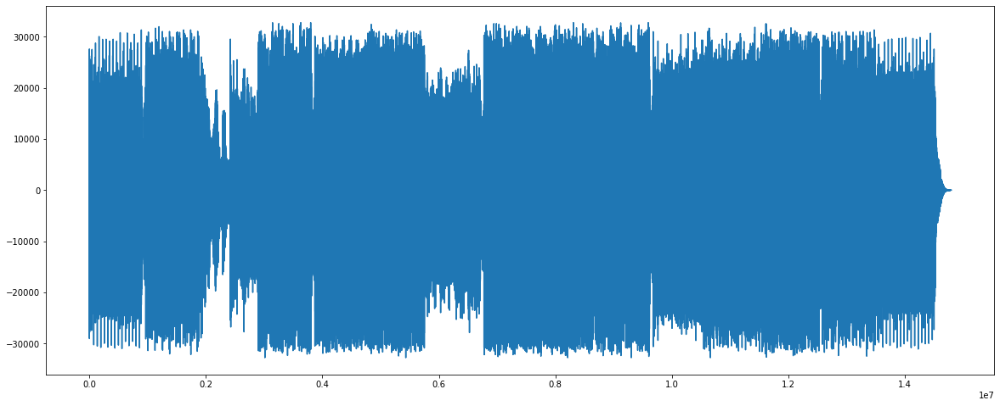

In [33]:
plt.figure(figsize=(20,8))
fs, data = wavfile.read(example)
signal = data.mean(axis=1)
plt.plot(signal)
plt.show()

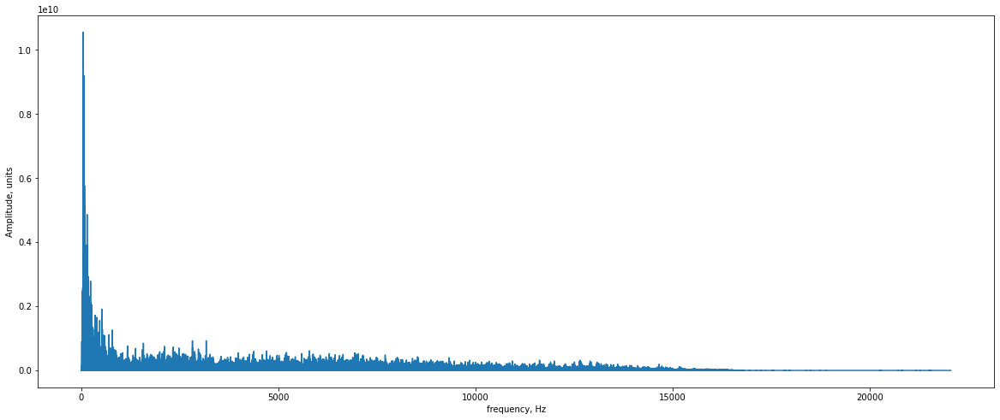

In [34]:
plt.figure(figsize=(20,8))
fs, data = wavfile.read(example)
signal = data.mean(axis=1)
signal = pad(signal)
N = signal.shape[0]
fft_spectrum = np.abs(FFT_vectorized(signal))
freq = fftfreq(signal.size, d=1.0/fs)
plt.plot(freq, fft_spectrum[range(int(N/2))])
plt.xlabel("frequency, Hz")
plt.ylabel("Amplitude, units")
plt.show()

### compared with Numpy implementation

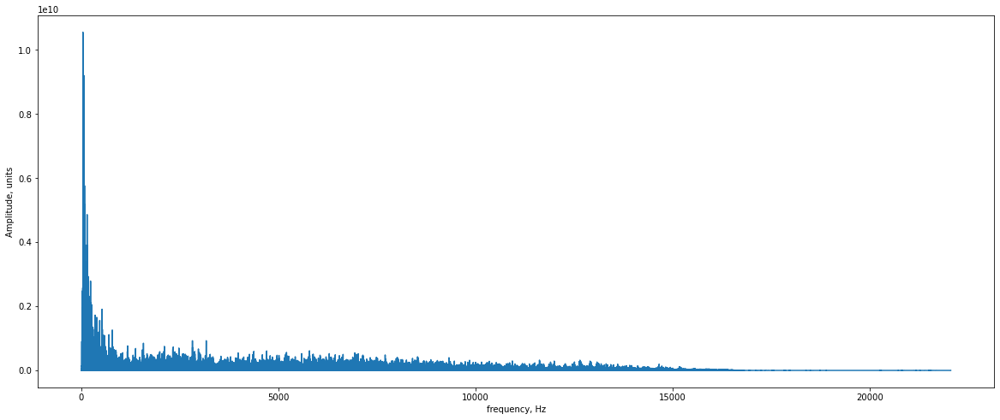

In [35]:
plt.figure(figsize=(20,8))
fs, data = wavfile.read(example)
signal = data.mean(axis=1)
signal = pad(signal)
N = signal.shape[0]
fft_spectrum = np.abs(np.fft.rfft(signal))
freq = np.fft.rfftfreq(signal.size, d=1.0/fs)
plt.plot(freq, fft_spectrum)
plt.xlabel("frequency, Hz")
plt.ylabel("Amplitude, units")
plt.show()

### Calculate FFT on a small time window

In [141]:
time_period = 1
fs, data = wavfile.read(example)
total_time = int(np.floor(len(data)/fs))
sample_range = np.arange(0,total_time,time_period)
total_samples = len(sample_range)

print ("Frequency sampling", fs)
print ("total time: ", total_time)
print ("sample time period: ", time_period)
print ("total samples: ", total_samples)

Frequency sampling 44100
total time:  335
sample time period:  1
total samples:  335


In [142]:
output_signal = []
output_fft = []
output_freq = []
for i in sample_range:

    print ("Processing: %d / %d (%d%%)" % (i/time_period + 1, total_samples, (i/time_period + 1)*100/total_samples))
    sample_start = int(i*fs)
    sample_end = int((i+time_period)*fs)
    signal = data[sample_start:sample_end]
    l_audio = len(signal.shape)
    if l_audio == 2: # two channel avg together
        signal = signal.mean(axis=1)
    signal = pad(signal)
    N = signal.shape[0]

    secs = N / float(fs)
    # print (secs)
    Ts = 1.0/fs # sampling interval in time

    t = np.arange(0, secs, Ts) # time vector

    FFT = np.abs(FFT_vectorized(signal))
    FFT_side = FFT[range(int(N/2))] 
    freq = fftfreq(signal.size, t[1]-t[0])

    # Normalize
    max_value = np.max(FFT_side)
    if (max_value != 0):
        FFT_side_norm = FFT_side / max_value

    # Append to output array
    output_signal.append(signal)
    output_fft.append(FFT_side_norm)
    output_freq.append(freq)


Processing: 1 / 335 (0%)
Processing: 2 / 335 (0%)
Processing: 3 / 335 (0%)
Processing: 4 / 335 (1%)
Processing: 5 / 335 (1%)
Processing: 6 / 335 (1%)
Processing: 7 / 335 (2%)
Processing: 8 / 335 (2%)
Processing: 9 / 335 (2%)
Processing: 10 / 335 (2%)
Processing: 11 / 335 (3%)
Processing: 12 / 335 (3%)
Processing: 13 / 335 (3%)
Processing: 14 / 335 (4%)
Processing: 15 / 335 (4%)
Processing: 16 / 335 (4%)
Processing: 17 / 335 (5%)
Processing: 18 / 335 (5%)
Processing: 19 / 335 (5%)
Processing: 20 / 335 (5%)
Processing: 21 / 335 (6%)
Processing: 22 / 335 (6%)
Processing: 23 / 335 (6%)
Processing: 24 / 335 (7%)
Processing: 25 / 335 (7%)
Processing: 26 / 335 (7%)
Processing: 27 / 335 (8%)
Processing: 28 / 335 (8%)
Processing: 29 / 335 (8%)
Processing: 30 / 335 (8%)
Processing: 31 / 335 (9%)
Processing: 32 / 335 (9%)
Processing: 33 / 335 (9%)
Processing: 34 / 335 (10%)
Processing: 35 / 335 (10%)
Processing: 36 / 335 (10%)
Processing: 37 / 335 (11%)
Processing: 38 / 335 (11%)
Processing: 39 /

### Visualization on 1s time window

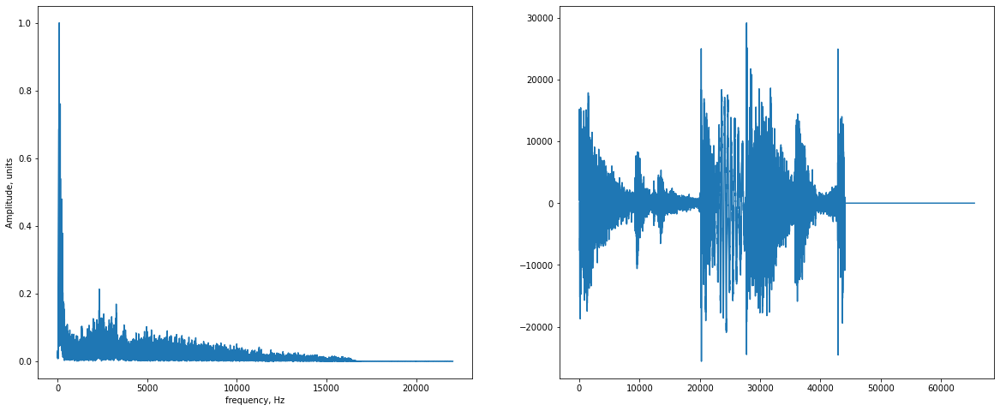

In [144]:
plt.figure(figsize=(20,8))
sec = 10
plt.subplot(1, 2, 1)
plt.plot(output_freq[sec], output_fft[sec])
plt.xlabel("frequency, Hz")
plt.ylabel("Amplitude, units")
plt.subplot(1, 2, 2)
plt.plot(output_signal[sec])
plt.show()

### Animation 1s window

In [147]:
%matplotlib notebook

In [151]:
from matplotlib.animation import FuncAnimation
fig = plt.figure(figsize=(20,8))
ax1 = fig.add_subplot(121, xlim = (0,10000), ylim = (0,0.5))
line1, = ax1.plot([],[])
ax2 = fig.add_subplot(122, xlim = (0,50000), ylim = (-30000,30000))
line2, = ax2.plot([])     # A tuple unpacking to unpack the only plot
sec = [i for i in range(0,len(output_freq))]
def animate(sec):
    line1.set_data((output_freq[sec], output_fft[sec]))
    line2.set_data((range(len(output_signal[sec])),output_signal[sec]))
    return line

anim = FuncAnimation(fig, animate, frames=len(sec))
from IPython.display import HTML
HTML(anim.to_jshtml())

<IPython.core.display.Javascript object>

Animation size has reached 21083549 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


### Some thoughts.
I learned FFT in school, but not really used it in my previous projects. My work and experience are about CV and NLP and mostly machine learning based.
FFT is mostly used for signal processing/ image compression which I'm not very familar with. 

From a view of machine learning, FFT is a kind of hand-crafted features and from its definition we can regard it as a simple linear combination of input. In this case, NN should easily simulate it, the specific weights of the fft linear combination should be able to learn by Gradient decsent. 

So Lets do an experiment, another way to implement FTT

In [156]:
from keras.models import Sequential
from keras.layers import Dense

In [163]:
N = 1024
batch = 10000
sig = np.random.randn(batch, N)
F = np.fft.fft(sig, axis=-1)# using numpy fft generate correct label for training

X = sig
Y = np.hstack([F.real, F.imag])

# real+imag, so N*2, no bias,activation needed according to FFT defination 
model = Sequential([Dense(N*2, input_dim=N, use_bias=False)])
model.compile(loss='mean_squared_error', optimizer='adam')
model.fit(X, Y, epochs=100, batch_size=100)

Epoch 1/100
100/100 [==============================] - 1s 9ms/step - loss: 492.5638
Epoch 2/100
100/100 [==============================] - 1s 9ms/step - loss: 449.2215
Epoch 3/100
100/100 [==============================] - 1s 9ms/step - loss: 409.2982
Epoch 4/100
100/100 [==============================] - 1s 9ms/step - loss: 372.3282
Epoch 5/100
100/100 [==============================] - 1s 9ms/step - loss: 338.1262
Epoch 6/100
100/100 [==============================] - 1s 9ms/step - loss: 306.5320
Epoch 7/100
100/100 [==============================] - 1s 9ms/step - loss: 277.3766
Epoch 8/100
100/100 [==============================] - 1s 9ms/step - loss: 250.5195
Epoch 9/100
100/100 [==============================] - 1s 10ms/step - loss: 225.8089
Epoch 10/100
100/100 [==============================] - 1s 9ms/step - loss: 203.1151
Epoch 11/100
100/100 [==============================] - 1s 9ms/step - loss: 182.3029
Epoch 12/100
100/100 [==============================] - 1s 9ms/step - los

In [168]:
def DFT_NN(x):
    if len(x) != N:
        raise ValueError(f'Only support length {N}')
    pred = model.predict(x[np.newaxis])[0]
    result = pred[:N] + 1j*pred[N:]
    return result

In [176]:
data = np.random.randn(N)
nn_result = DFT_NN(data)
np_result = np.fft.fft(data)

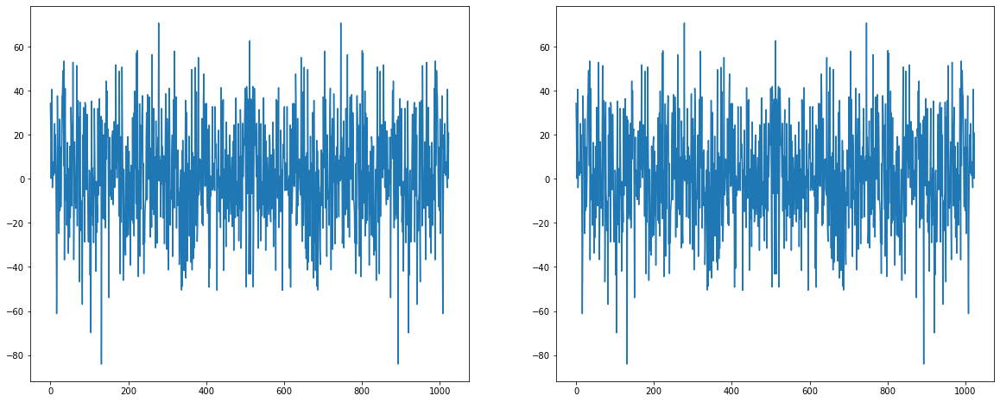

In [184]:
%matplotlib inline
plt.figure(figsize=(20,8))
sec = 10
plt.subplot(1, 2, 1)
plt.plot(nn_result.real)
plt.subplot(1, 2, 2)
plt.plot(np_result.real)
plt.show()

In [183]:
print('rmse: ', np.sqrt(np.mean((nn_result - np_result)**2)))

rmse:  (7.013775102110421e-08-0.0020227266189461464j)


### Just a rough experiment, but it shows the FFT and other linear transformations can be easily learned by NN. That might be the reasone why in modern DNN based audio analysis, we do not preprocessing and add hand crafted features into DNN. The NN can learn usefully features by its structure.